In [1]:
using StatsBase: mean

# Graph
using Graphs: SimpleGraph, connected_components
using SimpleWeightedGraphs: SimpleWeightedGraph

# Plot
using Plots: plot, savefig
using Colors: distinguishable_colors, @colorant_str
using GraphPlot: gplot, spring_layout
using Compose

# Original modules
include("../src/Output.jl")
include("../src/SimPlot.jl")
using .Output.Simulation
using .Output
using .SimPlot

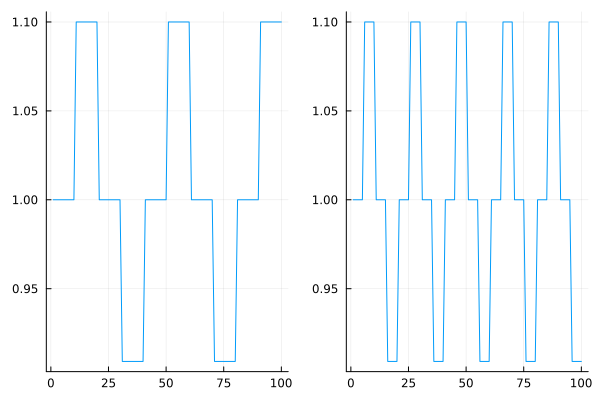

In [2]:
function make_variability(amplitude::Float64, quarter_wavelength::Int, limit::Int)::Vector{Float64}
    result = Vector{Float64}()
    values = [1.0, 1.0 + amplitude, 1.0, 1 / (1.0 + amplitude)]

    while length(result) < limit
        for v in values
            append!(result, repeat([v], quarter_wavelength))
        end
    end

    return result[1:limit]
end

plot(
    plot(make_variability(0.1, 10, 100), label = false),
    plot(make_variability(0.1, 5, 100), label = false)
)

# 環境変動がないケース

mean(output_df.N) = 100.0


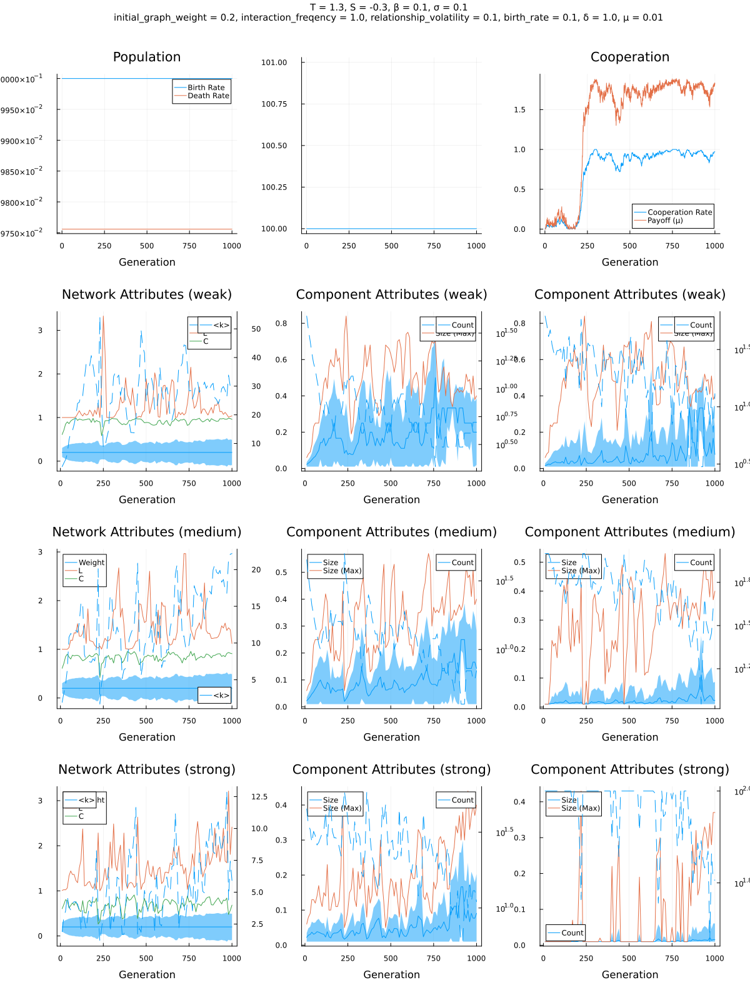

In [3]:
param = Param(
    initial_N = 100,
    initial_graph_weight = 0.2,
    T = 1.3,
    S = -0.3,
    δ = 1.0,
    μ = 0.01,
    generations = 1000,
)
model = Model(param)
# model.env_severity_vec = make_variability(0.2, 5, 100)
model.env_severity_vec = make_variability(0.0, 5, 100)

output_df = Output.make_output_df(model.param)
strategy_vec_vec = []
graph_weights_vec = []

for generation = 1:model.param.generations
    interaction!(model)
    death_and_birth!(model, generation)
    Output.log!(output_df, generation, model, true)
    push!(strategy_vec_vec, copy(model.strategy_vec))
    push!(graph_weights_vec, model.graph_weights)
end

@show mean(output_df.N)

p = SimPlot.plot_output_df(output_df)
savefig(p, "1.png")
display(p)

# 環境変動があるケース

mean(output_df.N) = 271.293


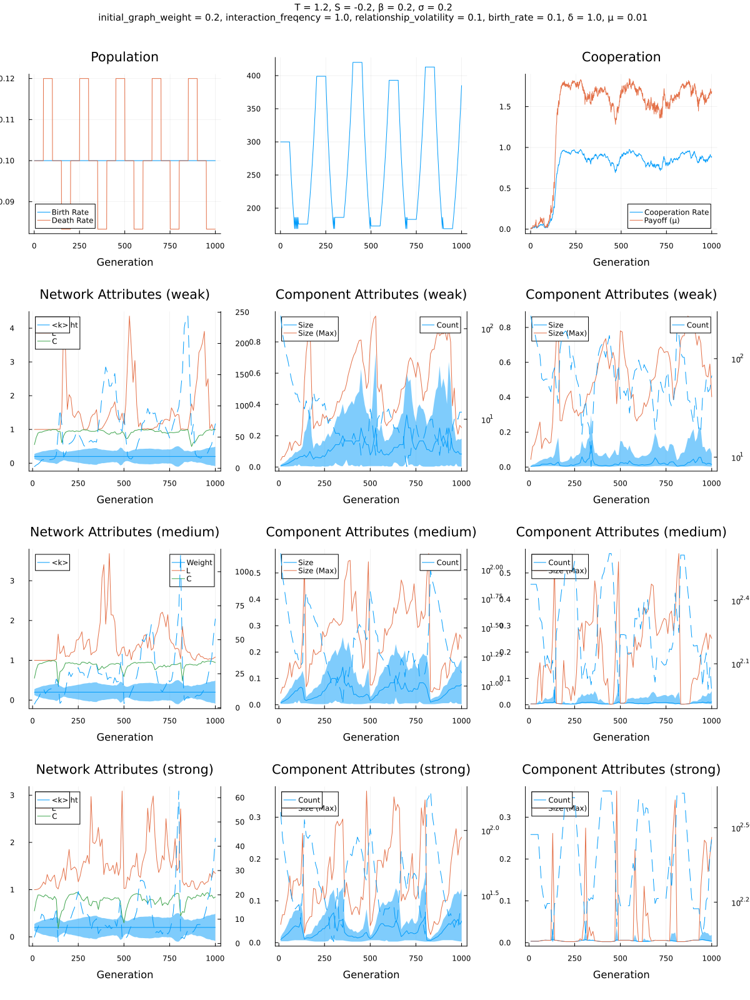

In [6]:
param = Param(
    initial_N = 300,
    initial_graph_weight = 0.2,
    T = 1.2,
    S = -0.2,
    δ = 1.0,
    β = 0.2,
    σ = 0.2,
    μ = 0.01,
    generations = 1000,
)
model = Model(param)
model.env_severity_vec = make_variability(0.2, 5, 100)
# model.env_severity_vec = make_variability([1.1, 10/11, 1.1, 10/11, 1.1, 10/11, 1.1, 10/11, 1.1, 10/11], fill(10, 10))
# model.strategy_vec = rand(model.param.rng, [C, D], model.param.initial_N)

output_df = Output.make_output_df(model.param)
strategy_vec_vec = []
graph_weights_vec = []

for generation = 1:model.param.generations
    interaction!(model)
    death_and_birth!(model, generation)
    Output.log!(output_df, generation, model, true)
    push!(strategy_vec_vec, copy(model.strategy_vec))
    push!(graph_weights_vec, model.graph_weights)
end

@show mean(output_df.N)

p = SimPlot.plot_output_df(output_df)
# savefig(p, "2.png")
display(p)

第100世代
協力率: 0.045454545454545456
弱い繋がりグループ: 19個, [27, 19, 10, 7, 6, 12, 8, 3, 3, 7, 18, 18, 18, 7, 5, 2, 4, 1, 1]
中程度の繋がりグループ: 19個, [27, 19, 10, 7, 6, 12, 8, 3, 3, 7, 18, 18, 18, 7, 5, 2, 4, 1, 1]
強い繋がりグループ: 26個, [27, 17, 10, 7, 6, 12, 2, 2, 2, 3, 2, 18, 13, 18, 6, 5, 2, 4, 5, 5, 1, 1, 5, 1, 1, 1]


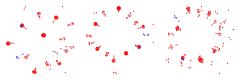

弱い繋がりグループ: 62個, [27, 19, 9, 1, 1, 12, 1, 1, 1, 1, 18, 18, 1, 18, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
中程度の繋がりグループ: 139個, [27, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 9, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 176個, [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

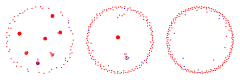

第110世代
協力率: 0.11363636363636363
弱い繋がりグループ: 16個, [21, 8, 9, 13, 3, 5, 21, 22, 6, 7, 12, 4, 13, 24, 3, 5]
中程度の繋がりグループ: 16個, [21, 8, 9, 13, 3, 5, 21, 22, 6, 7, 12, 4, 13, 24, 3, 5]
強い繋がりグループ: 27個, [21, 3, 2, 12, 3, 3, 21, 19, 6, 4, 12, 1, 1, 4, 13, 1, 7, 24, 3, 2, 1, 2, 1, 2, 5, 1, 2]


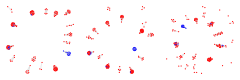

弱い繋がりグループ: 51個, [21, 1, 1, 13, 1, 1, 21, 22, 1, 1, 12, 1, 1, 13, 1, 7, 24, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
中程度の繋がりグループ: 132個, [1, 1, 1, 1, 1, 1, 1, 16, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 24, 1, 1, 1, 1, 1, 6, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 176個, [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

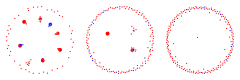

第120世代
協力率: 0.14204545454545456
弱い繋がりグループ: 15個, [24, 8, 22, 9, 8, 9, 10, 21, 17, 25, 3, 7, 8, 4, 1]
中程度の繋がりグループ: 15個, [24, 8, 22, 9, 8, 9, 10, 21, 17, 25, 3, 7, 8, 4, 1]
強い繋がりグループ: 20個, [24, 4, 22, 9, 8, 8, 10, 21, 16, 25, 1, 7, 1, 3, 4, 1, 1, 4, 2, 5]


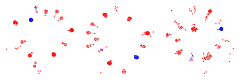

弱い繋がりグループ: 46個, [24, 1, 22, 9, 5, 6, 10, 21, 17, 25, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
中程度の繋がりグループ: 119個, [1, 1, 15, 1, 1, 1, 1, 1, 1, 1, 21, 1, 1, 20, 1, 1, 1, 1, 1, 1, 1, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 176個, [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

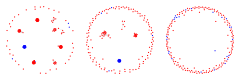

第130世代
協力率: 0.2784090909090909
弱い繋がりグループ: 15個, [4, 12, 46, 23, 3, 6, 6, 18, 14, 5, 9, 21, 3, 5, 1]
中程度の繋がりグループ: 16個, [4, 12, 46, 23, 2, 6, 6, 18, 14, 5, 9, 21, 3, 5, 1, 1]
強い繋がりグループ: 35個, [4, 12, 46, 2, 2, 3, 3, 1, 12, 5, 9, 2, 6, 2, 7, 1, 11, 2, 2, 1, 6, 5, 3, 1, 2, 6, 3, 1, 2, 1, 2, 5, 2, 3, 1]


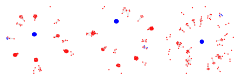

弱い繋がりグループ: 74個, [1, 1, 46, 23, 1, 1, 1, 1, 13, 1, 1, 1, 1, 21, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
中程度の繋がりグループ: 131個, [1, 1, 46, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 131個, [1, 1, 46, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

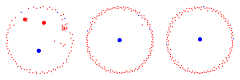

第140世代
協力率: 0.5568181818181818
弱い繋がりグループ: 13個, [16, 6, 7, 20, 96, 9, 2, 3, 3, 5, 2, 6, 1]
中程度の繋がりグループ: 48個, [6, 2, 1, 3, 96, 2, 1, 3, 4, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 3, 4, 3, 1, 4, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 121個, [1, 1, 1, 1, 3, 2, 1, 3, 1, 2, 1, 1, 1, 1, 2, 3, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 2, 3, 1, 1, 3, 2, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 1, 2, 1, 1, 3, 3, 2, 2, 2, 1, 1, 1, 1, 1, 1, 2, 1, 3, 1, 1, 1, 1, 1, 4, 2, 2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 2, 1, 3, 1, 1, 1, 1, 1, 1, 1]


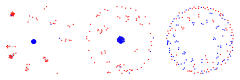

弱い繋がりグループ: 81個, [1, 1, 1, 1, 96, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
中程度の繋がりグループ: 81個, [1, 1, 1, 1, 96, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 176個, [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

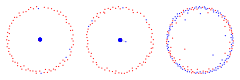

第150世代
協力率: 0.7272727272727273
弱い繋がりグループ: 16個, [3, 4, 129, 12, 1, 1, 4, 1, 3, 4, 6, 2, 3, 1, 1, 1]
中程度の繋がりグループ: 64個, [1, 3, 4, 4, 8, 3, 1, 2, 1, 4, 6, 6, 1, 3, 1, 1, 1, 4, 2, 2, 1, 3, 4, 3, 12, 9, 6, 2, 1, 1, 3, 3, 1, 1, 8, 1, 1, 1, 2, 2, 3, 3, 1, 5, 5, 2, 2, 3, 1, 1, 2, 5, 1, 1, 2, 1, 2, 4, 3, 2, 1, 1, 1, 1]
強い繋がりグループ: 89個, [1, 3, 1, 1, 6, 1, 1, 1, 1, 4, 4, 6, 1, 1, 1, 1, 1, 4, 2, 2, 1, 1, 2, 3, 8, 2, 1, 2, 1, 1, 2, 3, 1, 4, 1, 3, 1, 1, 1, 2, 3, 2, 3, 1, 2, 1, 1, 2, 2, 5, 1, 2, 3, 2, 3, 4, 2, 3, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 5, 2, 1, 4, 2, 1, 1, 1, 1, 3, 2, 4, 1, 1, 2, 2, 1, 1, 1, 1, 1]


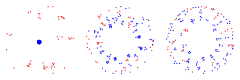

弱い繋がりグループ: 48個, [1, 1, 129, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
中程度の繋がりグループ: 176個, [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
強い繋がりグループ: 176個, [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

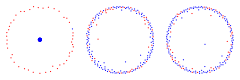

In [9]:
set_default_graphic_size(24cm, 8cm)

for i in 100:10:150
    color_val_vec = [s == C ? colorant"blue" : colorant"red" for s in strategy_vec_vec[i]]
    g25 = SimpleGraph(graph_weights_vec[i] .>= Output.WEAK_THRESHOLD)
    g50 = SimpleGraph(graph_weights_vec[i] .>= Output.MEDIUM_THRESHOLD)
    g75 = SimpleGraph(graph_weights_vec[i] .>= Output.STRONG_THRESHOLD)

    println("第$(i)世代")
    println("協力率: $(mean(strategy_vec_vec[i] .== C))")
    g25_components = [length(c) for c in connected_components(g25)]
    g50_components = [length(c) for c in connected_components(g50)]
    g75_components = [length(c) for c in connected_components(g75)]
    println("弱い繋がりグループ: $(length(g25_components))個, $(g25_components)")
    println("中程度の繋がりグループ: $(length(g50_components))個, $(g50_components)")
    println("強い繋がりグループ: $(length(g75_components))個, $(g75_components)")

    display(hstack(
        gplot(g25, nodefillc=color_val_vec, spring_layout(g25, C = 4.0)...),
        gplot(g50, nodefillc=color_val_vec, spring_layout(g50, C = 4.0)...),
        gplot(g75, nodefillc=color_val_vec, spring_layout(g75, C = 4.0)...)
    ))

    N = size(graph_weights_vec[i], 1)
    initial_graph_weight = 0.2
    graph_weights = Output.convert_to_2nd_order_weights(graph_weights_vec[i], N, initial_graph_weight)
    Simulation.normalize_graph_weights!(graph_weights, N, initial_graph_weight)
    g25 = SimpleGraph(graph_weights .>= Output.WEAK_THRESHOLD)
    g50 = SimpleGraph(graph_weights .>= Output.MEDIUM_THRESHOLD)
    g75 = SimpleGraph(graph_weights .>= Output.STRONG_THRESHOLD)
    g25_components = [length(c) for c in connected_components(g25)]
    g50_components = [length(c) for c in connected_components(g50)]
    g75_components = [length(c) for c in connected_components(g75)]
    println("弱い繋がりグループ: $(length(g25_components))個, $(g25_components)")
    println("中程度の繋がりグループ: $(length(g50_components))個, $(g50_components)")
    println("強い繋がりグループ: $(length(g75_components))個, $(g75_components)")

    display(hstack(
        gplot(g25, nodefillc=color_val_vec, spring_layout(g25, C = 4.0)...),
        gplot(g50, nodefillc=color_val_vec, spring_layout(g50, C = 4.0)...),
        gplot(g75, nodefillc=color_val_vec, spring_layout(g75, C = 4.0)...)
    ))
end

# なぜ人口が減ったら協力が成立し易くなるの？

In [ ]:
param = Param(
    initial_N = 200,
    initial_graph_weight = 0.2,
    relationship_volatility = 0.0,
    T = 1.2,
    S = -0.2,
    δ = 1.0,
    μ = 0.01,
    generations = 1000,
)
model = Model(param)
model.env_severity_vec = make_variability(0.0, 5, 100)

output_df = Output.make_output_df(model.param)
strategy_vec_vec = []
graph_weights_vec = []

for generation = 1:model.param.generations
    interaction!(model)
    death_and_birth!(model, generation)
    Output.log!(output_df, generation, model, true)
    push!(strategy_vec_vec, copy(model.strategy_vec))
    push!(graph_weights_vec, model.graph_weights)
end

@show mean(output_df.N)

p = SimPlot.plot_output_df(output_df)
display(p)

In [ ]:
param = Param(
    initial_N = 400,
    initial_graph_weight = 0.2,
    relationship_volatility = 0.0,
    T = 1.2,
    S = -0.2,
    δ = 1.0,
    μ = 0.01,
    generations = 1000,
)
model = Model(param)
model.env_severity_vec = make_variability(0.0, 5, 100)

output_df = Output.make_output_df(model.param)
strategy_vec_vec = []
graph_weights_vec = []

for generation = 1:model.param.generations
    interaction!(model)
    death_and_birth!(model, generation)
    Output.log!(output_df, generation, model, true)
    push!(strategy_vec_vec, copy(model.strategy_vec))
    push!(graph_weights_vec, model.graph_weights)
end

@show mean(output_df.N)

p = SimPlot.plot_output_df(output_df)
display(p)